# Installation Stuff

In [ ]:
%pip install git+https://github.com/neelnanda-io/TransformerLens.git
%pip install hdbscan

  Cloning https://github.com/neelnanda-io/TransformerLens.git to /tmp/pip-req-build-fbmzkli5
  Running command git clone --filter=blob:none --quiet https://github.com/neelnanda-io/TransformerLens.git /tmp/pip-req-build-fbmzkli5
  Resolved https://github.com/neelnanda-io/TransformerLens.git to commit 218ebd6f491f47f5e2f64e4c4327548b60a093eb
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
import transformer_lens
import torch
import torch.nn as nn
from scipy.cluster.hierarchy import linkage, dendrogram, to_tree
import matplotlib.pyplot as plt
import numpy as np
import random
from scipy.sparse import csgraph
import hdbscan
import PIL
from IPython.display import display, Image

# Prep Work

In [ ]:
def show_heatmap(m, row_ids=None, vmin=-1, vmax=1, scale=8):
  if row_ids is None:
    row_ids = range(m.shape[0])
  dpi = 50
  fig = plt.figure(figsize=(len(row_ids)*scale/dpi,len(row_ids)*scale/dpi), dpi=dpi)
  ax = fig.add_subplot(111)
  cax = ax.imshow(m[row_ids,:][:,row_ids], cmap='RdBu', vmin=vmin, vmax=vmax)
  fig.colorbar(cax)
  return fig

def greedy_tsp_solver(dists):
  unused_dists = dists.clone().cuda()
  USED = 1000000

  paths = {}
  for i in range(unused_dists.shape[0]):
    paths[i] = [i]
    unused_dists[i,i] = USED
  merged = []
  expnpaths = len(paths)
  for i in range(unused_dists.shape[0] - 1):
    a, b = np.unravel_index(unused_dists.argmin().cpu().detach().numpy(), unused_dists.shape)
    pa, pb = paths[a], paths[b]
    merged = paths[a] + paths[b][::-1]
    l, r = merged[0], merged[-1]
    unused_dists[[l,r],[r,l]] = USED
    unused_dists[merged[1:-1],:] = USED
    unused_dists[:,merged[1:-1]] = USED
    for el in merged:
      paths[el] = merged
    npaths = len(set(map(id, paths.values())))
    expnpaths -= 1
    if npaths != expnpaths:
      print(npaths, expnpaths)
      print(f'Failure to merge paths {a} and {b} ({pa} {pb})')
      raise Exception()
  return merged

## Load the model

In [ ]:
model = transformer_lens.HookedTransformer.from_pretrained("tiny-stories-2L-33M")

Using pad_token, but it is not set yet.


Loaded pretrained model tiny-stories-2L-33M into HookedTransformer


## Verify that it produces reasonable completions

In [ ]:
tokens = model.to_tokens(['Once upon', 'When the'])
for i in range(100):
  cpl = model(tokens).argmax(dim=-1)
  tokens = torch.hstack([tokens, cpl[:,-1:]])

for individual_completion in tokens:
  print(model.tokenizer.decode(individual_completion))

<|endoftext|>Once upon a time, there was a little girl named Lucy. She was three years old and loved to play outside. One day, she was playing in the garden when she saw a big, red tomato. She was so excited and wanted to pick it.

But then she heard a voice. It was her mom. "Lucy, don't pick that tomato! It's not ready yet," her mom said.

Lucy was sad, but she listened to her mom. She knew
<|endoftext|>When the sun went down, the little girl went back inside. She was tired but happy. She had a fun day playing outside and being with her friends.
Summary: A little girl goes outside to play with her friends and has a fun day playing in the sun.
Story: Once upon a time, there was a little girl. She was very happy. She liked to play outside in the sun. The sun was very bright and warm.

One day, the little girl went outside to


In [ ]:
tokens = model.to_tokens(['On the table were a sword and a shield. Jim picked up the shield, and Jane picked up the'])
for i in range(1):
  cpl = model(tokens).argmax(dim=-1)
  tokens = torch.hstack([tokens, cpl[:,-1:]])

for individual_completion in tokens:
  print(model.tokenizer.decode(individual_completion))

<|endoftext|>On the table were a sword and a shield. Jim picked up the shield, and Jane picked up the sword


# The good part

## Let's look at layer 1 mlp_out

**Hypothesis**: only the direction matter.

Since mlp_out is 4096 x 1024 (`d_mlp` x `d_model`), we want to compare directions within the model space, we will transform to get a list of 4096 unit vectors

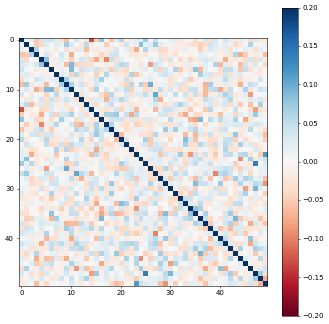

In [ ]:
mlpout = model.get_parameter('blocks.0.mlp.W_out').detach().cpu()
mlpout.shape
mlpout_norm = mlpout / mlpout.norm(dim=-1, keepdim=True)
# verify
mags = (mlpout_norm**2).sum(dim=-1)
mags.shape, mags.min(), mags.max()
# Because these are unit vectors the cosine similarity is the same thing as the
# dot product.
cos_sim = torch.einsum('an,bn->ab', mlpout_norm, mlpout_norm)
show_heatmap(cos_sim, row_ids=range(50), vmin=-0.2, vmax=0.2)

# Distance metric of the actual euclidean distance will try to order neurons
# such that ones that are similar in direction are closer to one another
# dists = torch.sqrt(2*cos_sim.max() - 2*cos_sim)

# Alternative distance metric will try to order neurons such that the ones that
# interfere more (positively _or_ negatively) are closer to one another
dists = torch.sqrt((cos_sim**2).max() - cos_sim**2)

In [ ]:
merged = greedy_tsp_solver(dists)
print(f"len(merged) should be {len(dists)}, is {len(merged)}")

len(merged) should be 4096, is 4096


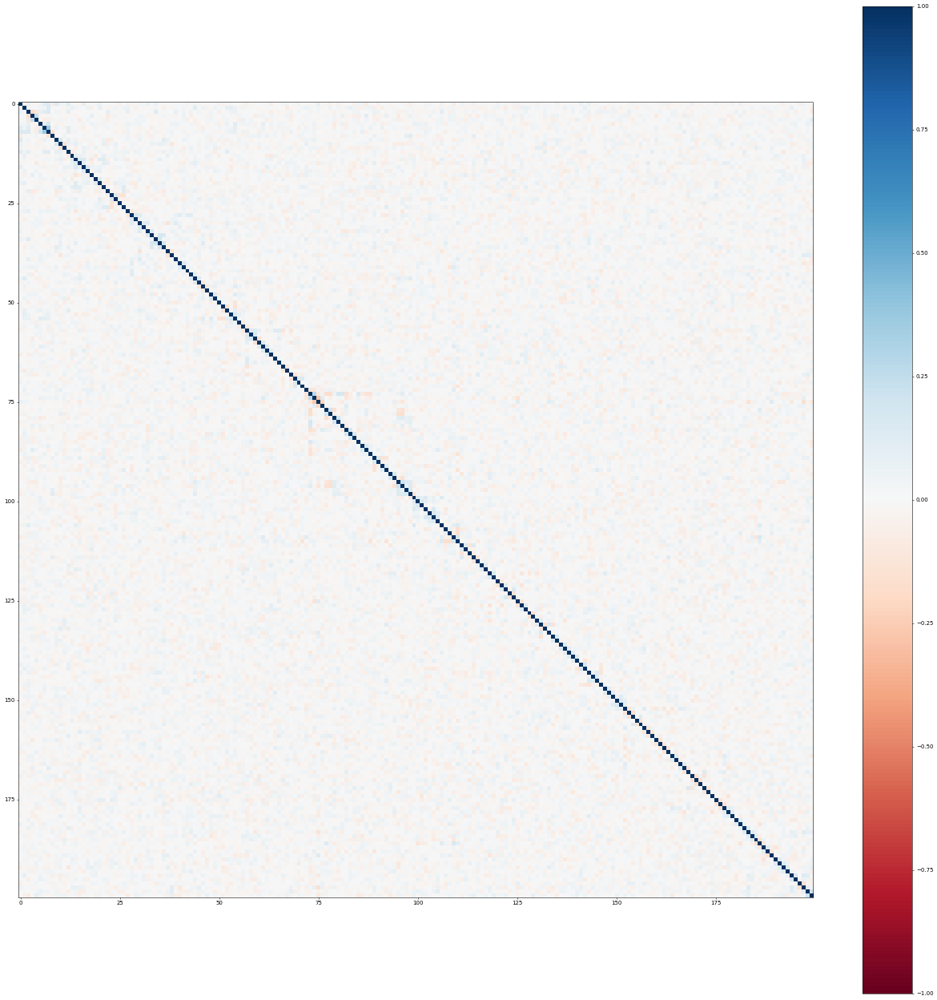

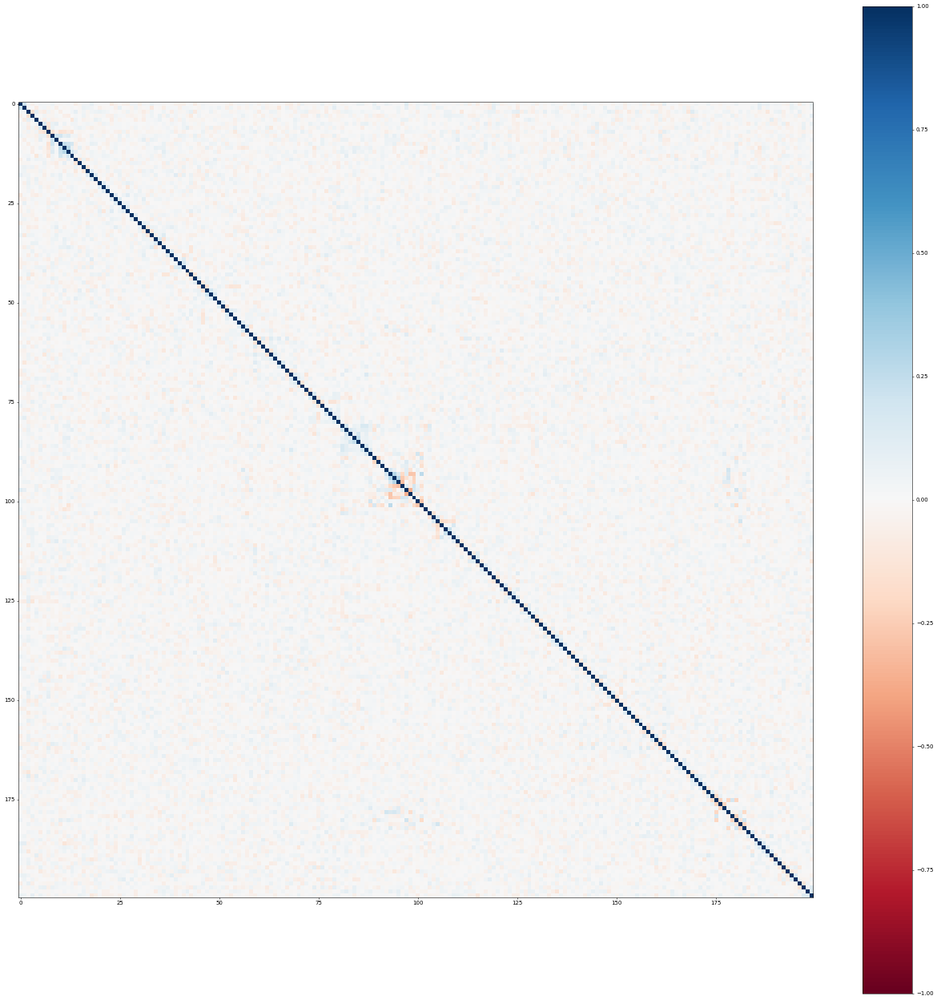

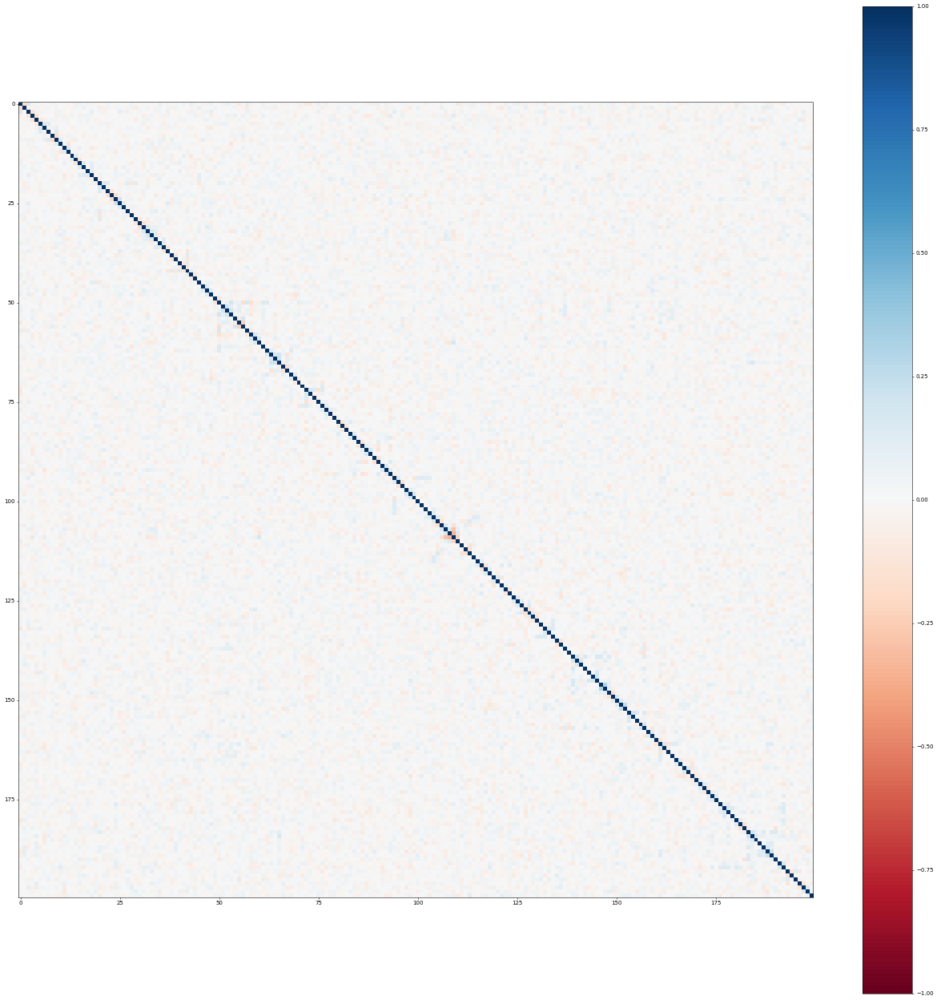

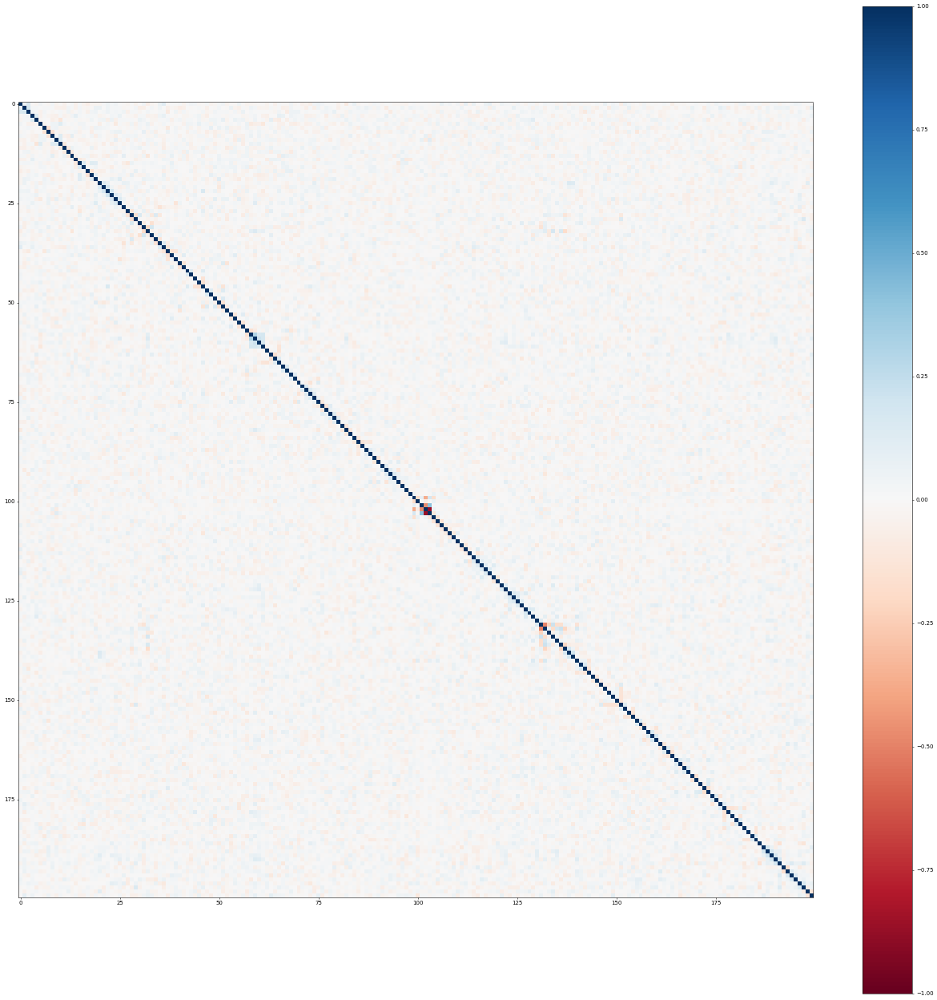

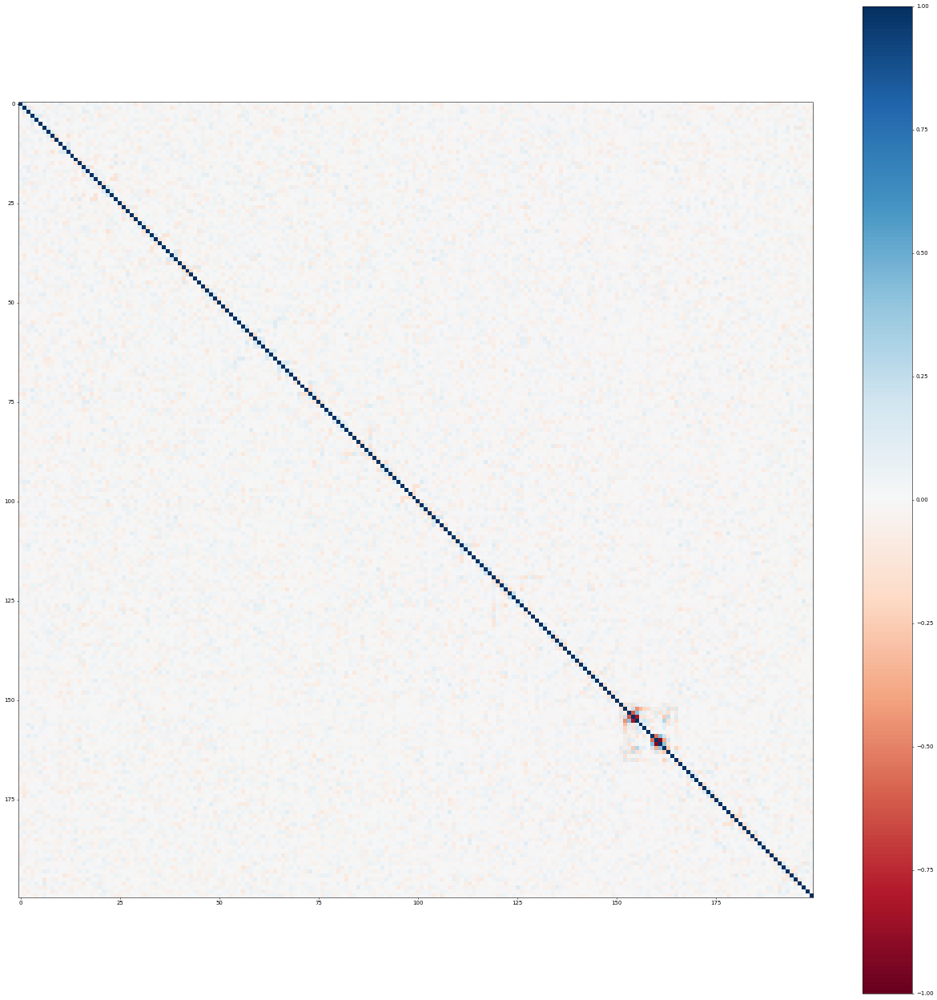

...

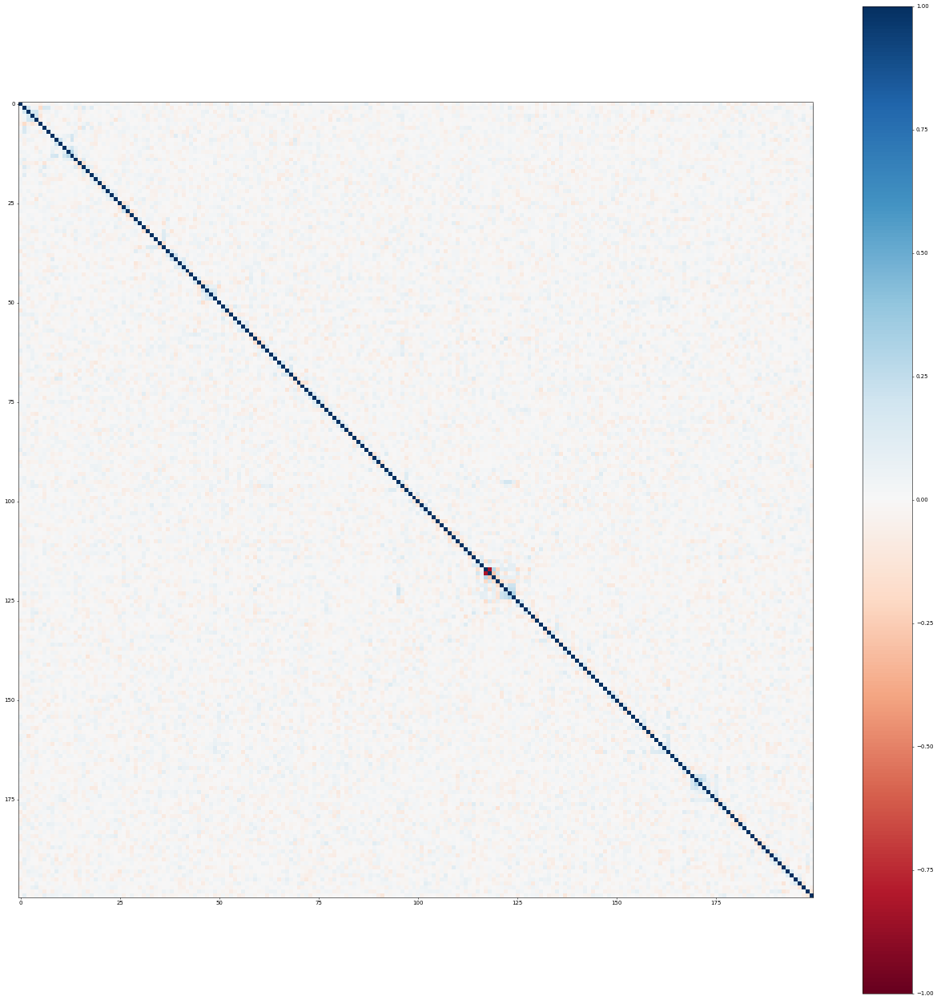

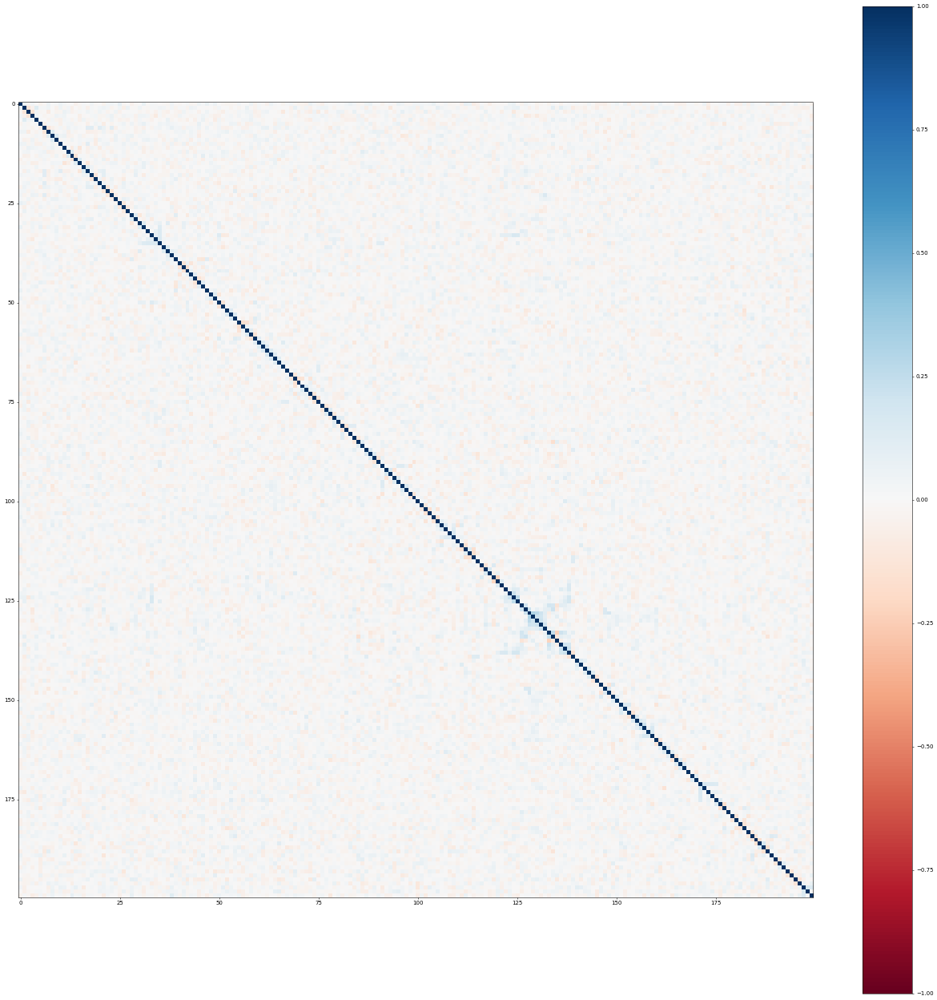

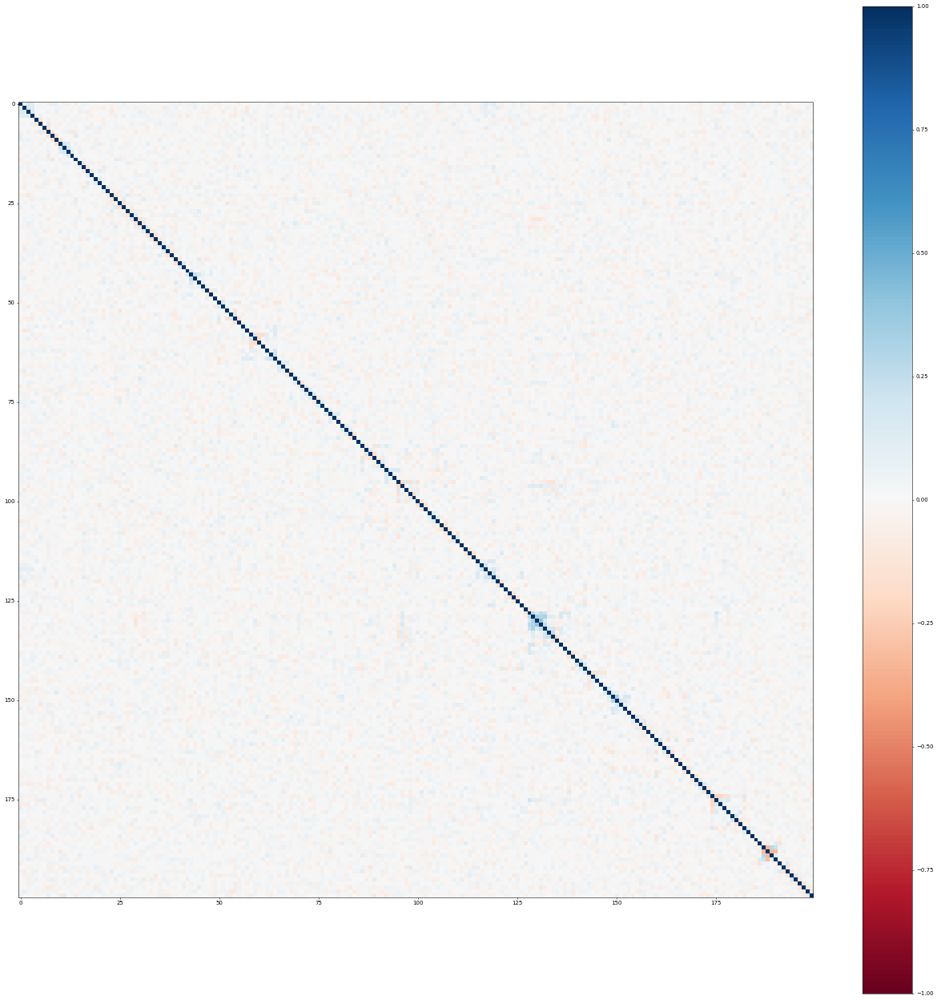

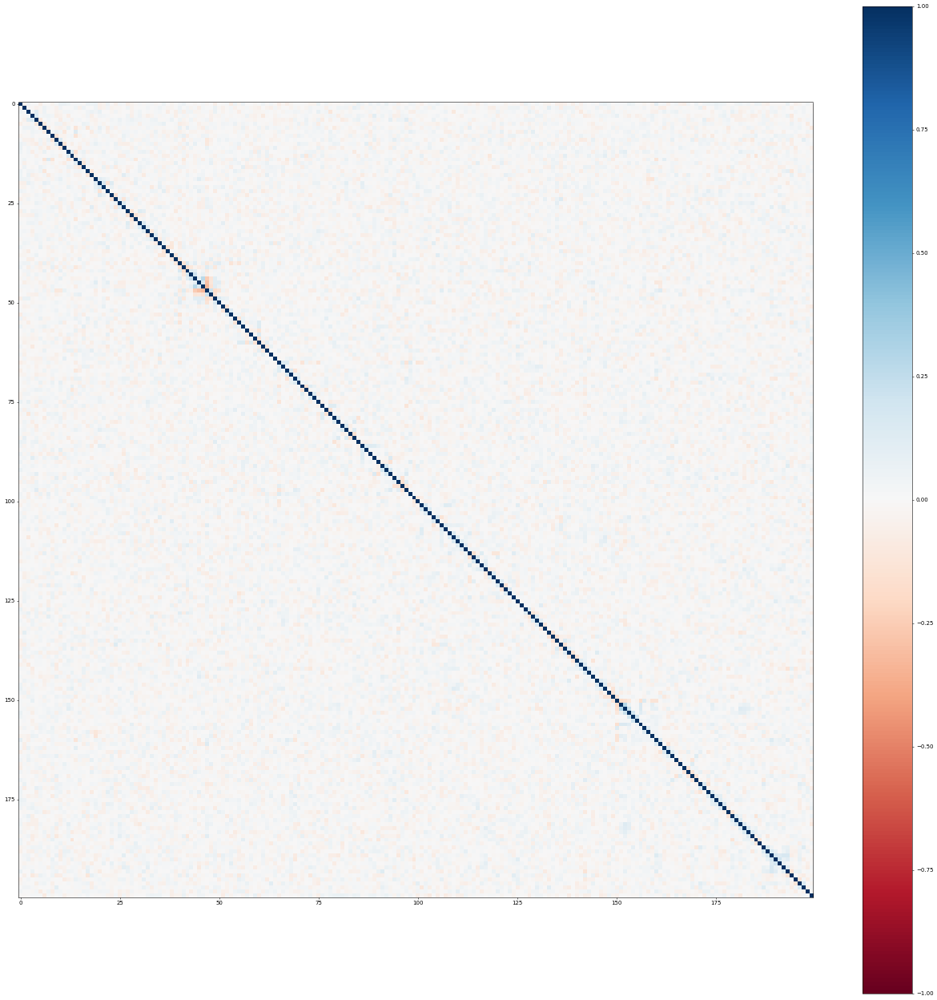

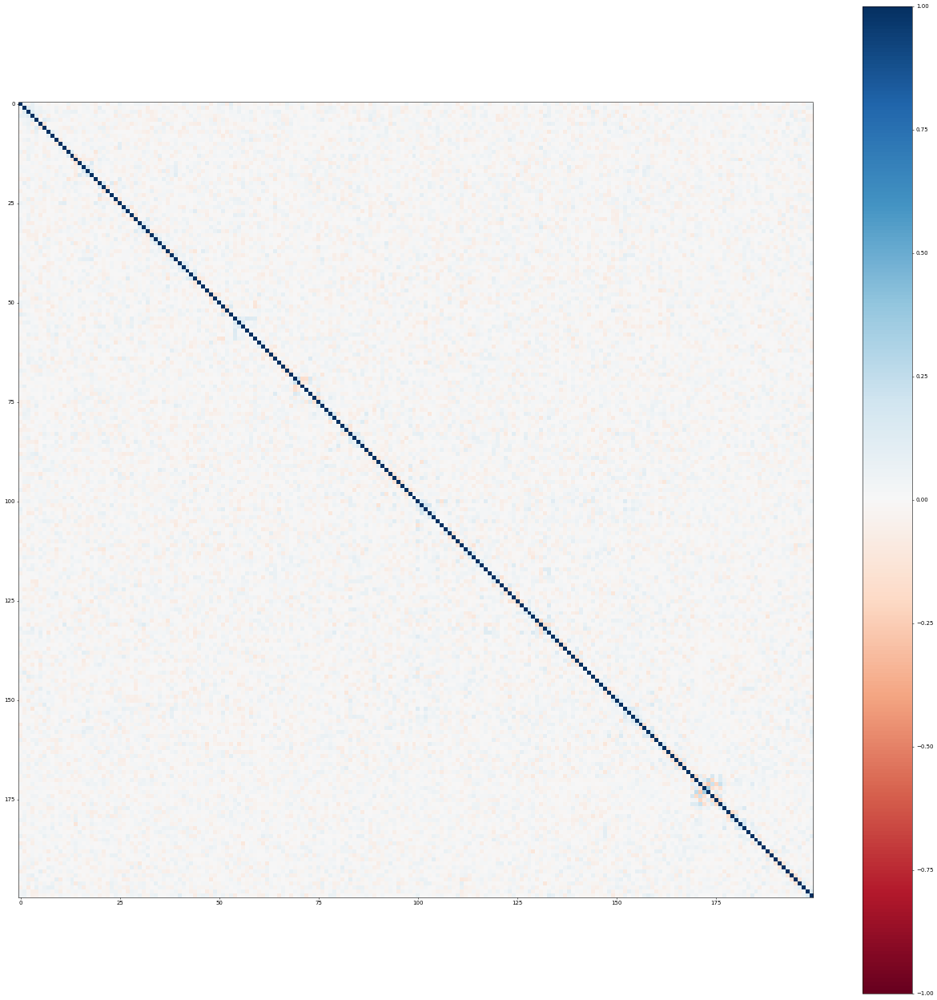

In [ ]:
for i in range(len(merged) // 200):
  show_heatmap(cos_sim, row_ids=merged[i*200:(i+1)*200], vmin=-1, vmax=+1)

In [ ]:
import numpy as np

def easing(t):
    # Easing function to control the animation speed
    return np.sin(np.pi / 2 * t)

def smooth_zoom_in(start_box, end_box, num_frames):
    # Smooth zooming from start_box to end_box
    boxes = []
    for i in range(num_frames):
        t = easing(i / (num_frames - 1))
        box = [int((1 - t) * start + t * end) for start, end in zip(start_box, end_box)]
        boxes.append(box)
    return boxes

def smooth_zoom_diagonal(diagonal_length, start_box, box_width, max_speed, num_frames):
    # Smooth zooming along the diagonal line with a maximum speed
    num_steps = diagonal_length // max_speed
    speed = diagonal_length / num_steps

    boxes = []
    for i in range(num_steps + 1):
        t = easing(i / num_steps)
        offset = int(t * (diagonal_length - box_width))
        box = [start + offset for start in start_box]
        box[2] = box[0] + box_width
        box[3] = box[1] + box_width
        boxes.append(box)
    return boxes

def smooth_zoom_out(start_box, end_box, num_frames):
    # Smooth zooming out from start_box to end_box
    boxes = []
    for i in range(num_frames):
        t = easing(i / (num_frames - 1))
        box = [int(t * start + (1 - t) * end) for start, end in zip(start_box, end_box)]
        boxes.append(box)
    return boxes[::-1]

# Define the initial and final bounding boxes
start_box = [0, 0, 4096, 4096]
end_box = [0, 0, 200, 200]
final_box = [3896, 3896, 4096, 4096]

# Generate the series of bounding boxes for smooth zooming effects
zoom_in_boxes = smooth_zoom_in(start_box, end_box, num_frames=100)
zoom_diagonal_boxes = smooth_zoom_diagonal(start_box[2] - start_box[0], end_box, box_width=200, max_speed=20, num_frames=100)
zoom_out_boxes = smooth_zoom_out(final_box, start_box, num_frames=100)

# Print the series of bounding boxes for visualization
print(zoom_in_boxes)
print(zoom_diagonal_boxes)
print(zoom_out_boxes)


[[0, 0, 4096, 4096], [0, 0, 4034, 4034], [0, 0, 3972, 3972], [0, 0, 3910, 3910], [0, 0, 3848, 3848], [0, 0, 3787, 3787], [0, 0, 3725, 3725], [0, 0, 3664, 3664], [0, 0, 3602, 3602], [0, 0, 3541, 3541], [0, 0, 3480, 3480], [0, 0, 3419, 3419], [0, 0, 3358, 3358], [0, 0, 3298, 3298], [0, 0, 3237, 3237], [0, 0, 3177, 3177], [0, 0, 3117, 3117], [0, 0, 3057, 3057], [0, 0, 2998, 2998], [0, 0, 2939, 2939], [0, 0, 2880, 2880], [0, 0, 2821, 2821], [0, 0, 2763, 2763], [0, 0, 2705, 2705], [0, 0, 2648, 2648], [0, 0, 2590, 2590], [0, 0, 2533, 2533], [0, 0, 2477, 2477], [0, 0, 2421, 2421], [0, 0, 2365, 2365], [0, 0, 2310, 2310], [0, 0, 2256, 2256], [0, 0, 2201, 2201], [0, 0, 2148, 2148], [0, 0, 2094, 2094], [0, 0, 2041, 2041], [0, 0, 1989, 1989], [0, 0, 1937, 1937], [0, 0, 1886, 1886], [0, 0, 1836, 1836], [0, 0, 1786, 1786], [0, 0, 1736, 1736], [0, 0, 1687, 1687], [0, 0, 1639, 1639], [0, 0, 1591, 1591], [0, 0, 1544, 1544], [0, 0, 1498, 1498], [0, 0, 1452, 1452], [0, 0, 1407, 1407], [0, 0, 1363, 1363],

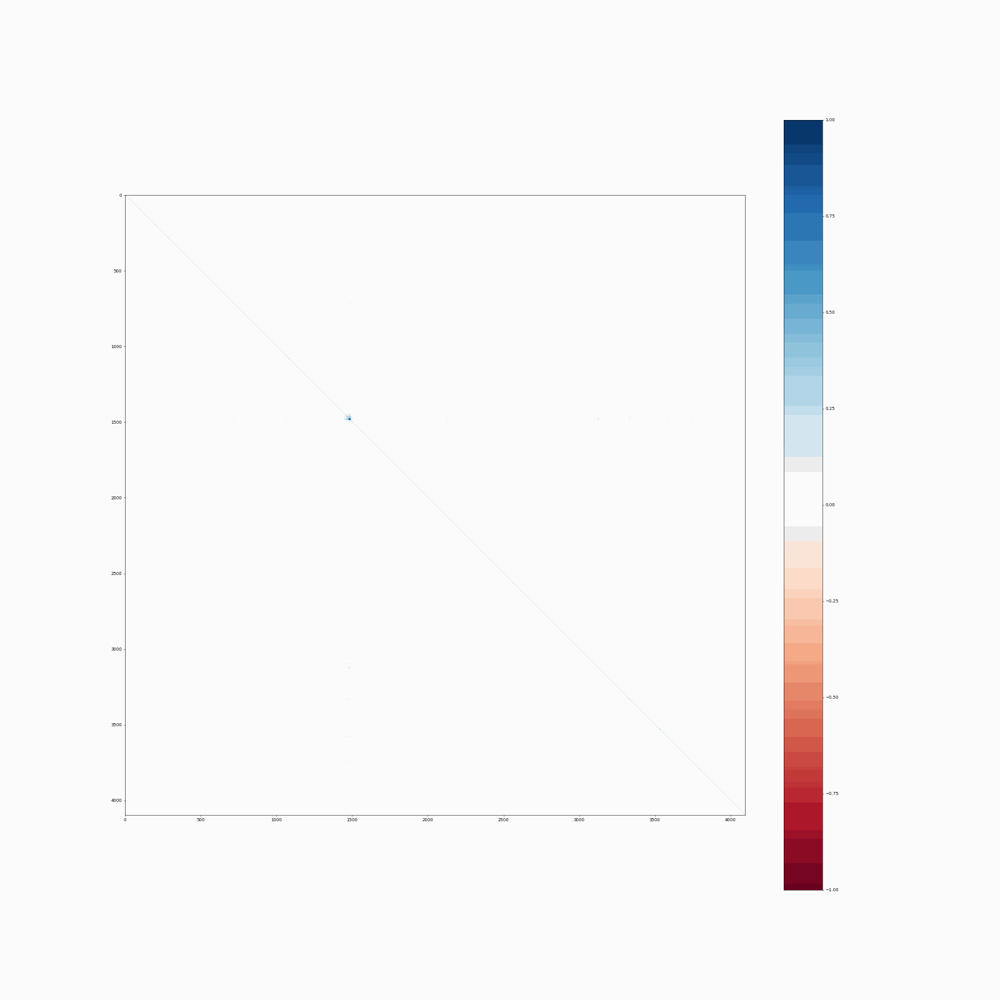

In [ ]:
images = []
image_path_template = "heatmap_frame_{}.png"
frame_configs = [
  *smooth_zoom_in(start_box, end_box, num_frames=100),
  *smooth_zoom_diagonal(start_box[2] - start_box[0], end_box, box_width=200, max_speed=20, num_frames=100),
  *smooth_zoom_out(final_box, start_box, num_frames=100),
]

for i, (left, _l, right, _r) in enumerate(frame_configs):
  fig = show_heatmap(cos_sim, row_ids=merged[left:right], vmin=-1, vmax=+1, scale=1600/(right - left))
  image_path = image_path_template.format(i)
  plt.savefig(image_path)
  image = PIL.Image.open(image_path)
  images.append(image)
  plt.close()

gif_path = "heatmap_animation.gif"
images[0].save(gif_path, save_all=True, append_images=images[1:], optimize=False, duration=100, loop=0)

display(Image(filename=gif_path))

## Confirm that similar structures do _not_ show up in a random 4096x1024 tensor

I can't imagine they would, but seeing how much structure this technique picks up in a random 4096x1024 tensor would test that.

Shape should be (4096, 1024), is torch.Size([4096, 1024])
mags.shape/min/max should be ((4096,), 1.0, 1.0), is (torch.Size([4096]), tensor(1.0000), tensor(1.0000))
Small (50x50) sample of what rnd_cos_sim looks like
len(rnd_merged) should be 4096, is 4096


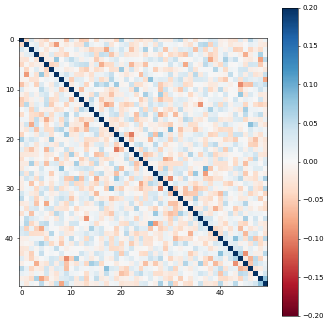

In [ ]:
rnd = torch.randn(4096, 1024)
print(f"Shape should be (4096, 1024), is {rnd.shape}")

rnd_norm = rnd / rnd.norm(dim=-1, keepdim=True)
# verify
mags = (rnd_norm**2).sum(dim=-1)
mags.shape, mags.min(), mags.max()
print(f"mags.shape/min/max should be ((4096,), 1.0, 1.0), is {(mags.shape, mags.min(), mags.max())}")
rnd_cos_sim = torch.einsum('an,bn->ab', rnd_norm, rnd_norm)
print("Small (50x50) sample of what rnd_cos_sim looks like")
show_heatmap(rnd_cos_sim, row_ids=range(50), vmin=-0.2, vmax=0.2)
# Use the alternative distance metric here
rnd_dists = torch.sqrt((rnd_cos_sim**2).max() - rnd_cos_sim**2)
rnd_merged = greedy_tsp_solver(rnd_dists)
print(f"len(rnd_merged) should be 4096, is {len(rnd_merged)}")

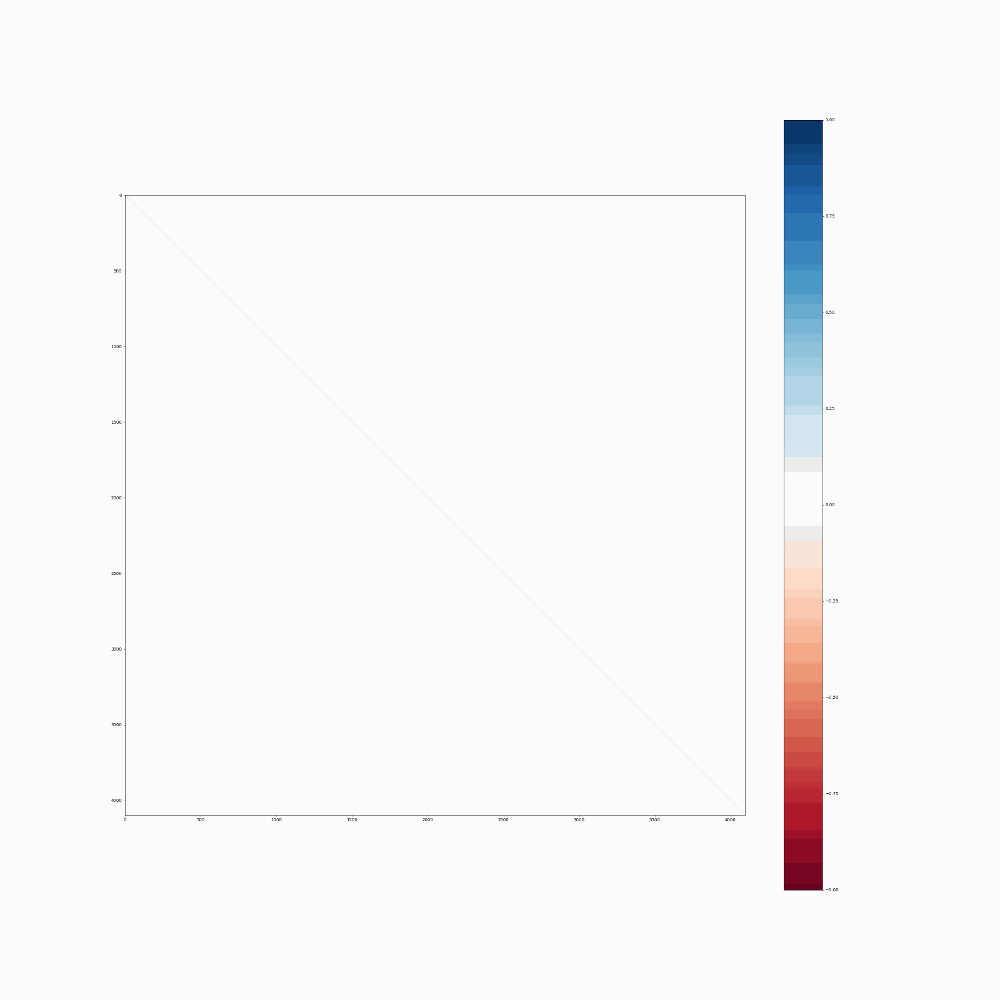

In [ ]:
images = []
image_path_template = "heatmap_frame_{}.png"
frame_configs = [
  *smooth_zoom_in(start_box, end_box, num_frames=100),
  *smooth_zoom_diagonal(start_box[2] - start_box[0], end_box, box_width=200, max_speed=20, num_frames=100),
  *smooth_zoom_out(final_box, start_box, num_frames=100),
]

for i, (left, _l, right, _r) in enumerate(frame_configs):
  fig = show_heatmap(rnd_cos_sim, row_ids=rnd_merged[left:right], vmin=-1, vmax=+1, scale=1600/(right - left))
  image_path = image_path_template.format(i)
  plt.savefig(image_path)
  image = PIL.Image.open(image_path)
  images.append(image)
  plt.close()

gif_path = "heatmap_animation.gif"
images[0].save(gif_path, save_all=True, append_images=images[1:], optimize=False, duration=100, loop=0)

display(Image(filename=gif_path))